In [23]:
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from scipy import signal
import rawpy
from skimage import exposure, restoration
from skimage.io import imread
import seaborn as sns

In [43]:
stim = np.load('stim.npy')

In [10]:
def show_im_well(img, ppi=96):
    ppi = float(ppi)
    fig = plt.figure(figsize=(img.shape[1]/ppi, img.shape[0]/ppi), dpi=ppi)
    bbox = fig.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    fig_width, fig_height = bbox.width*fig.dpi, bbox.height*fig.dpi
    ax= fig.add_axes([0, 0, 1, 1], frameon=False, xticks=[], yticks=[])
    ax.imshow(img, cmap='gray', interpolation='none')
    return fig

The following is the actual image that gets displayed on the screen. To me, there looks like a small amount of aliasing in the display below, but there isn't when it's displayed; you can check the saved `stim.png` to see this.

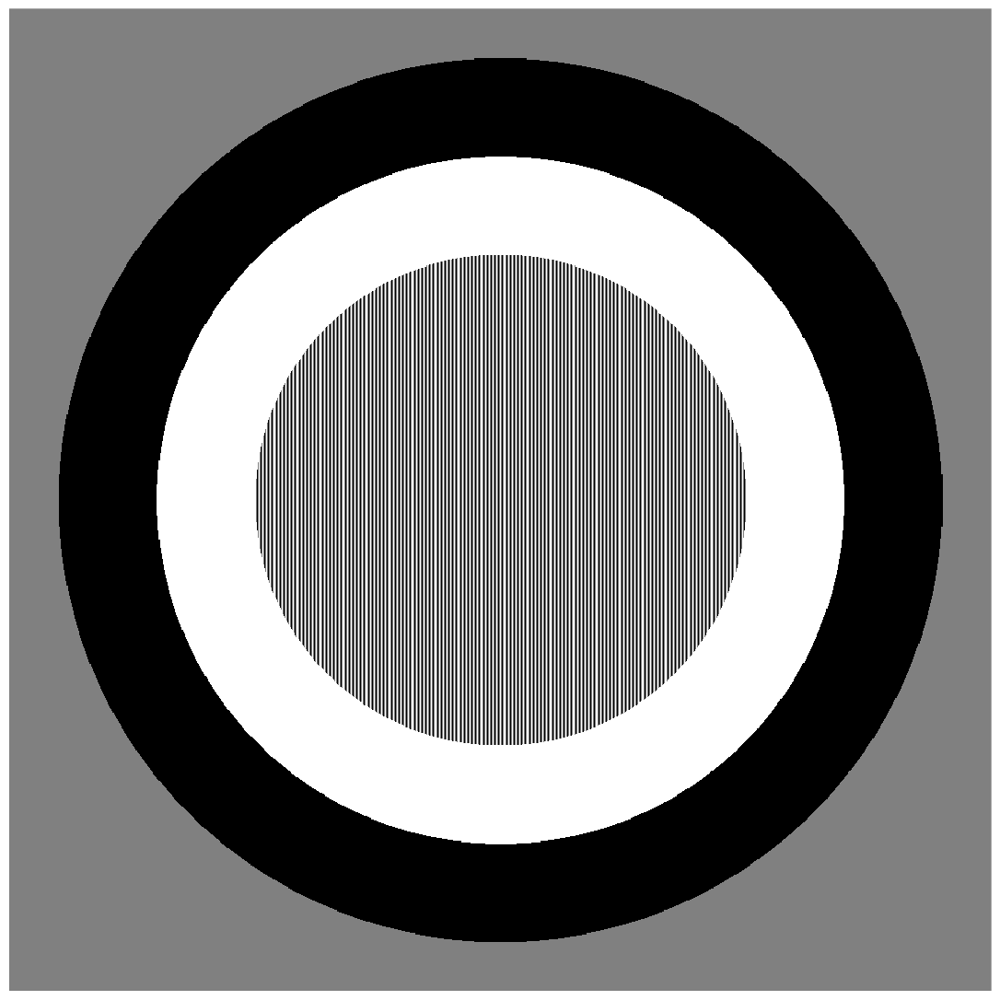

In [41]:
fig = show_im_well(stim)
fig.savefig('stim.png', dpi=96)

I now load in the raw image and the JPG that the camera saves. I saved the JPG at the max possible resolution and did my best to turn off as much processing as I could, but at the very least, there's demosaicing, whitebalancing, and some JPG compression.

I then convert both to black and white using the "luminosity" method described here: https://www.johndcook.com/blog/2009/08/24/algorithms-convert-color-grayscale/ (the default used by GIMP, seems reasonable to me).

I don't do any whitebalance adjustment on the raw image I'm decoding here, just demosaicing and converting to black and white. (I think? I'm pretty sure rawpy doesn't do anything by default)

In [26]:
raw = rawpy.imread('data/P1011254.ORF')
raw_rgb = raw.postprocess()
raw_bw=(0.21*raw_rgb[:,:,0])+(0.72*raw_rgb[:,:,1])+(0.07*raw_rgb[:,:,2])

jpg = imread('data/P1011254.JPG')
jpg_bw=(0.21*jpg[:,:,0])+(0.72*jpg[:,:,1])+(0.07*jpg[:,:,2])

In [37]:
# They're slightly different sizes:
print("Raw image size: %s, %s" % raw_bw.shape)
print("JPG image size: %s, %s" % jpg_bw.shape)

Raw image size: 3040, 4056
JPG image size: 3024, 4032


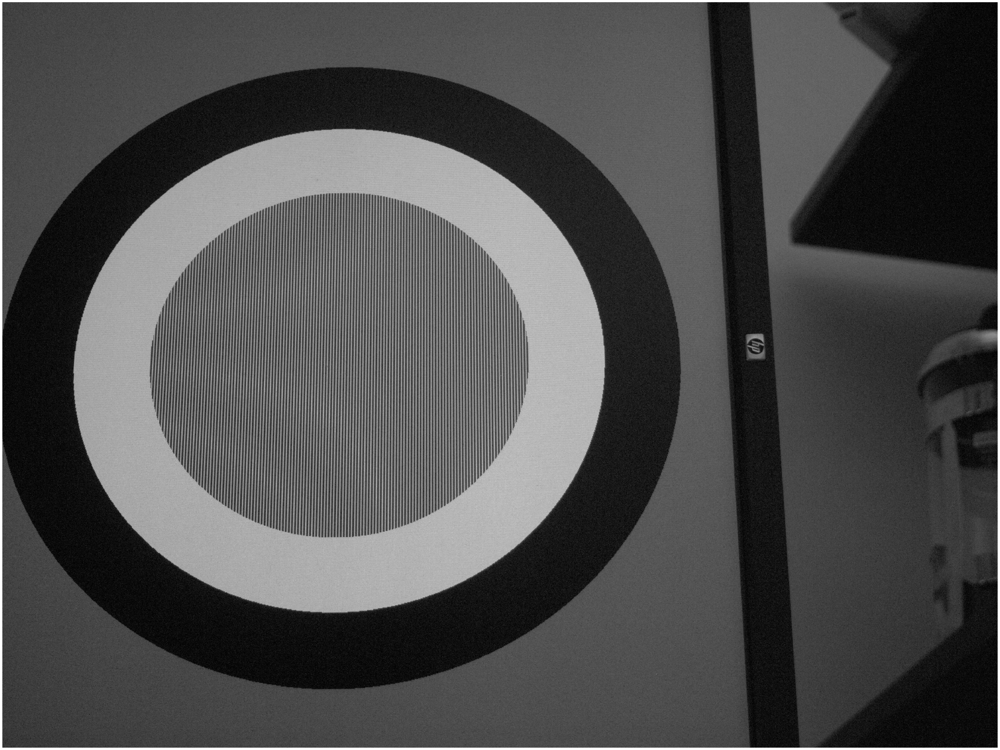

In [27]:
# Raw image that I've decoded using a little python above
fig=show_im_well(raw_bw)

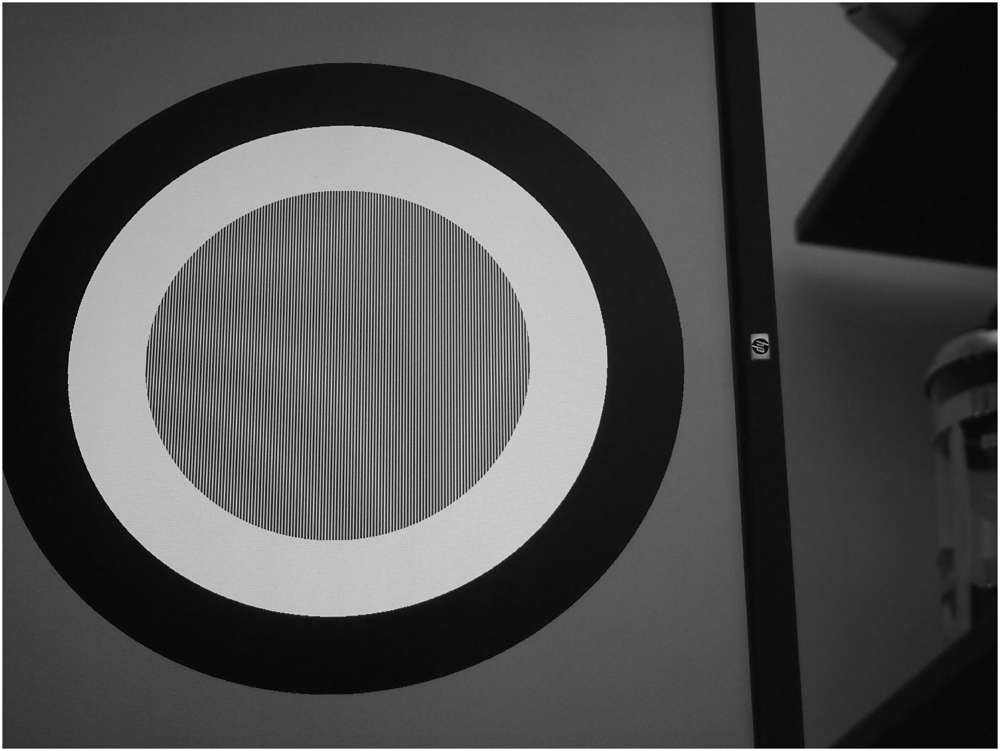

In [19]:
# JPEG
fig = show_im_well(jpg_bw)

The following is a slice through the middle of the two images (even though they're different sizes, they should correspond to about the same portion of the image).

You can see the raw one looks to have lost a little bit of contrast for the grating, while the jpg has not.

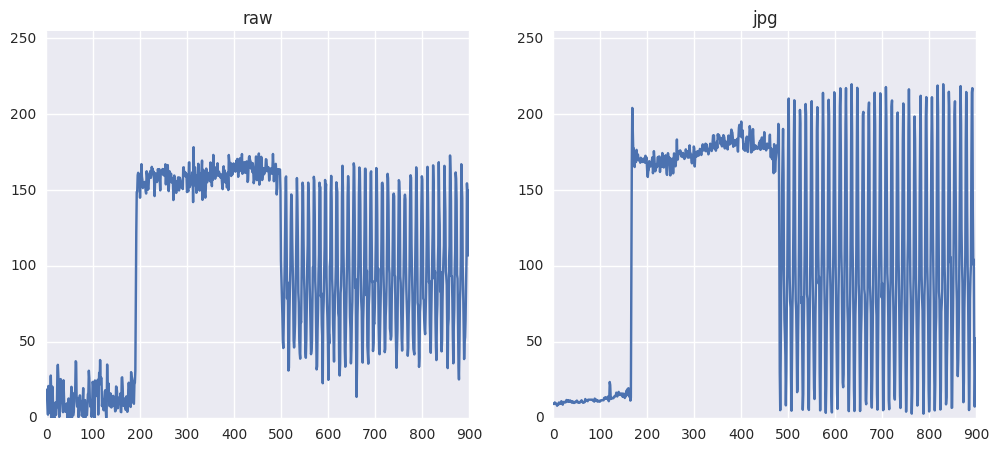

In [38]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
for ax, im, title in zip(axes, [raw_bw, jpg_bw], ['raw', 'jpg']):
    ax.plot(im[3040/2, 100:1000])
    ax.set_title(title)
    ax.set_ylim((0, 255))